In [1]:
# must run in an environment where polarityJaM is installed
from polarityjam import Extractor, Plotter, CellposeSegmenter, PropertiesCollection
from polarityjam import RuntimeParameter, PlotParameter, SegmentationParameter, ImageParameter
from polarityjam.utils.io import read_image

from pathlib import Path

# Setup

In [2]:
### ADAPT ME ###
input_file = Path("/home/jpa/tmp/polarityjam/data/golgi_nuclei/set_1/060721_EGM2_18dyn_01.tif")
output_path = Path("/home/jpa/tmp/polarityjam_out/")
output_file_prefix = "060721_EGM2_18dyn_01"
### ADAPT ME ###

In [3]:
# read input
img = read_image(input_file)

# describe your image with ImageParameter
params_image = ImageParameter()

# set the channels
params_image.channel_organelle = 0  # golgi channel
params_image.channel_nucleus = 2
params_image.channel_junction = 3
params_image.channel_expression_marker = 3
params_image.pixel_to_micron_ratio = 2.4089

print(params_image)

ImageParameter:  
channel_junction              3                                       
channel_nucleus               2                                       
channel_organelle             0                                       
channel_expression_marker     3                                       
pixel_to_micron_ratio         2.4089                                  



In [4]:
# define other parameters, use default values
params_runtime = RuntimeParameter()
params_seg = SegmentationParameter()
params_plot = PlotParameter()

# other option to load in parameters - a yaml file
#params_input = InputParameter.from_yml(path_to_yml)

In [5]:
# look at our params to check them
print(params_runtime)
print(params_seg)
print(params_plot)

RuntimeParameter:  
membrane_thickness            5                                       
feature_of_interest           cell_area                               
min_cell_size                 50                                      
min_nucleus_size              10                                      
min_organelle_size            10                                      
dp_epsilon                    5                                       

SegmentationParameter:  
manually_annotated_mask                                               
store_segmentation            False                                   
use_given_mask                True                                    
model_type                    cyto                                    
model_path                                                            
estimated_cell_diameter       100                                     
flow_threshold                0.4                                     
cellprob_threshold            0

# Segmentation

In [6]:
# Define your segmenter and segment your image
cellpose_segmentation = CellposeSegmenter(params_seg)
img_channels, img_channels_params = cellpose_segmentation.prepare(img, params_image)

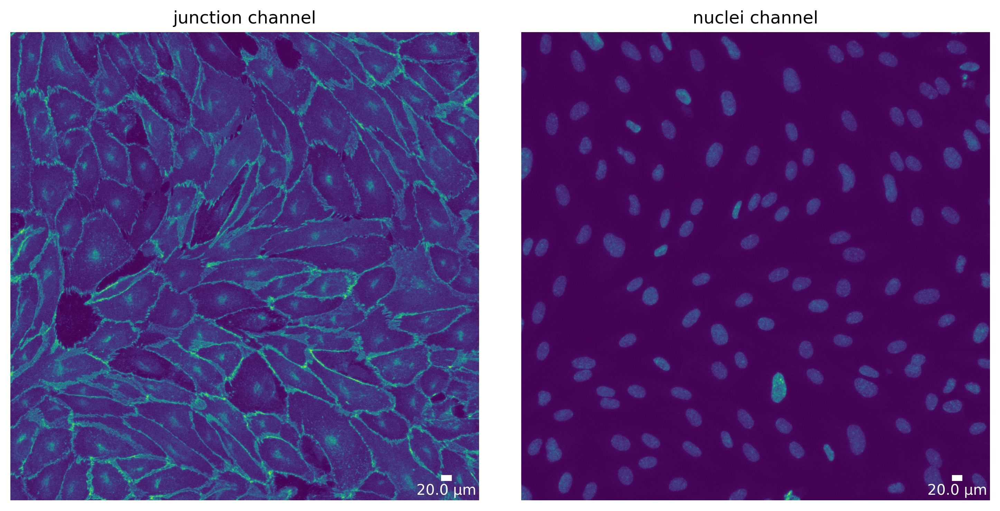

In [7]:
# Define a plotter and check your image that is prepared for segmentation
plotter = Plotter(params_plot)

# plot input
plotter.plot_channels(img_channels, img_channels_params, output_path, input_file)

cellprob_threshold and dist_threshold are being deprecated in a future release, use mask_threshold instead


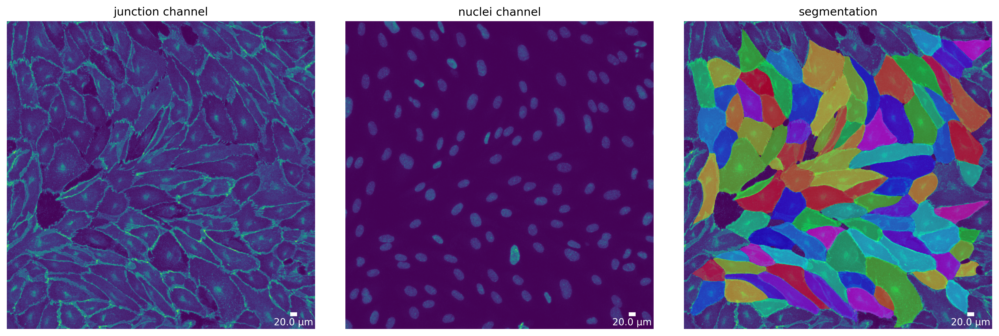

In [8]:
# segment your image
mask = cellpose_segmentation.segment(img_channels, input_file)

# plot segmentation mask to check the quality
plotter.plot_mask(mask, img_channels, img_channels_params, output_path, output_file_prefix)

# Feature extraction

In [9]:
# feature extraction
collection = PropertiesCollection()
extractor = Extractor(params_runtime)
extractor.extract(img, params_image, mask, output_file_prefix, output_path, collection)

In [10]:
collection.dataset.head()

,filename,img_hash,label,cell_X,cell_Y,cell_shape_orientation_rad,cell_shape_orientation_deg,cell_major_axis_length,cell_minor_axis_length,cell_eccentricity,...,morans_p_norm,neighbors_cell,neighbors_mean_dif_1st,neighbors_median_dif_1st,neighbors_stddev_dif_1st,neighbors_range_dif_1st,neighbors_mean_dif_2nd,neighbors_median_dif_2nd,neighbors_stddev_dif_2nd,neighbors_range_dif_2nd
1,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,17.0,68.477653,804.993960,2.525143,144.680027,114.164720,69.789749,0.791393,...,0.096469,3.0,-499.333333,-265.0,855.157036,2055.0,2421.250000,2092.0,3161.303637,7365.0
2,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,18.0,112.365152,216.717906,1.772854,101.577056,131.758840,79.042332,0.800074,...,0.096469,4.0,830.500000,1023.5,997.362647,2629.0,1808.666667,1028.0,3788.546540,11784.0
3,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,19.0,88.122335,962.746247,0.031579,1.809338,118.404769,67.778780,0.819952,...,0.096469,1.0,-1244.000000,-1244.0,0.000000,0.0,267.500000,267.5,132.500000,265.0
4,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,20.0,155.107352,459.765362,1.453797,83.296443,157.325719,138.722923,0.471705,...,0.096469,4.0,-6958.750000,-6791.0,2145.264713,5777.0,-10233.000000,-10853.0,1680.279739,5444.0
5,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,21.0,107.061672,906.465671,2.409574,138.058415,144.501883,37.908917,0.964975,...,0.096469,3.0,1422.333333,1379.0,166.149197,400.0,5066.000000,5066.0,3011.000000,6022.0


In [11]:
collection.dataset.to_csv(output_path.joinpath('features.csv'))

# Visualization

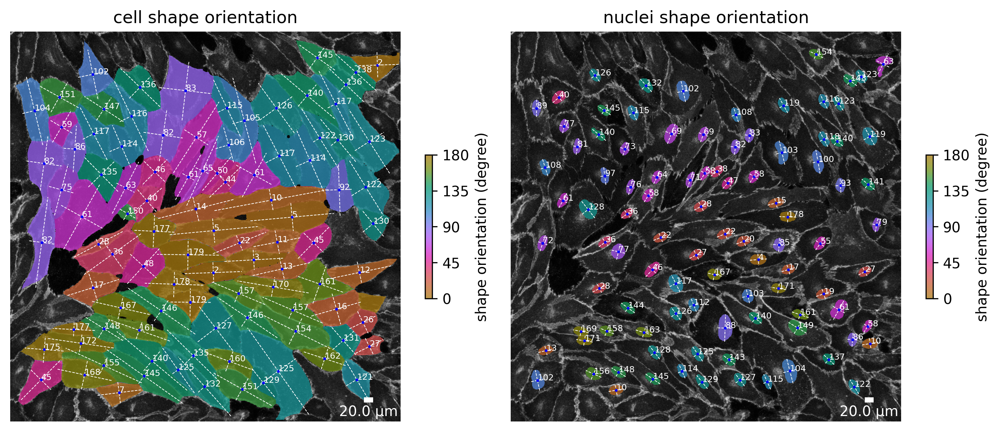

In [12]:
# plot the cell orienttion of a specific image in your collection
plotter.plot_orientation(collection, "060721_EGM2_18dyn_01")  # image is automatically saved in output_path

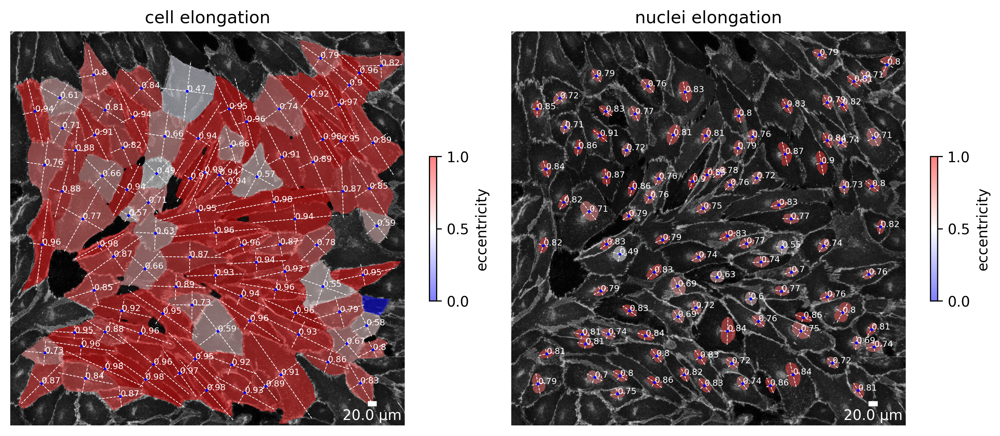

In [13]:
plotter.plot_eccentricity(collection, "060721_EGM2_18dyn_01")

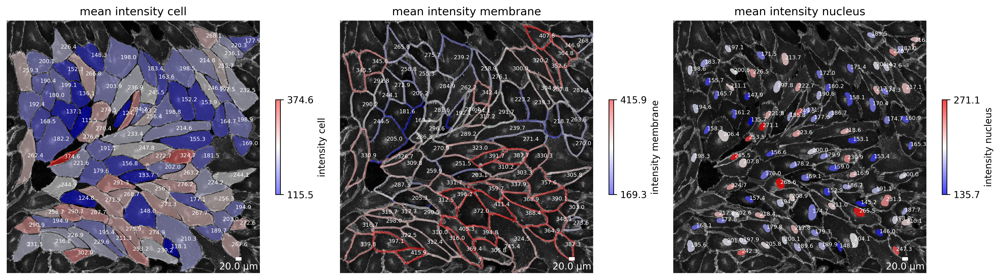

In [14]:
plotter.plot_marker_expression(collection, "060721_EGM2_18dyn_01")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


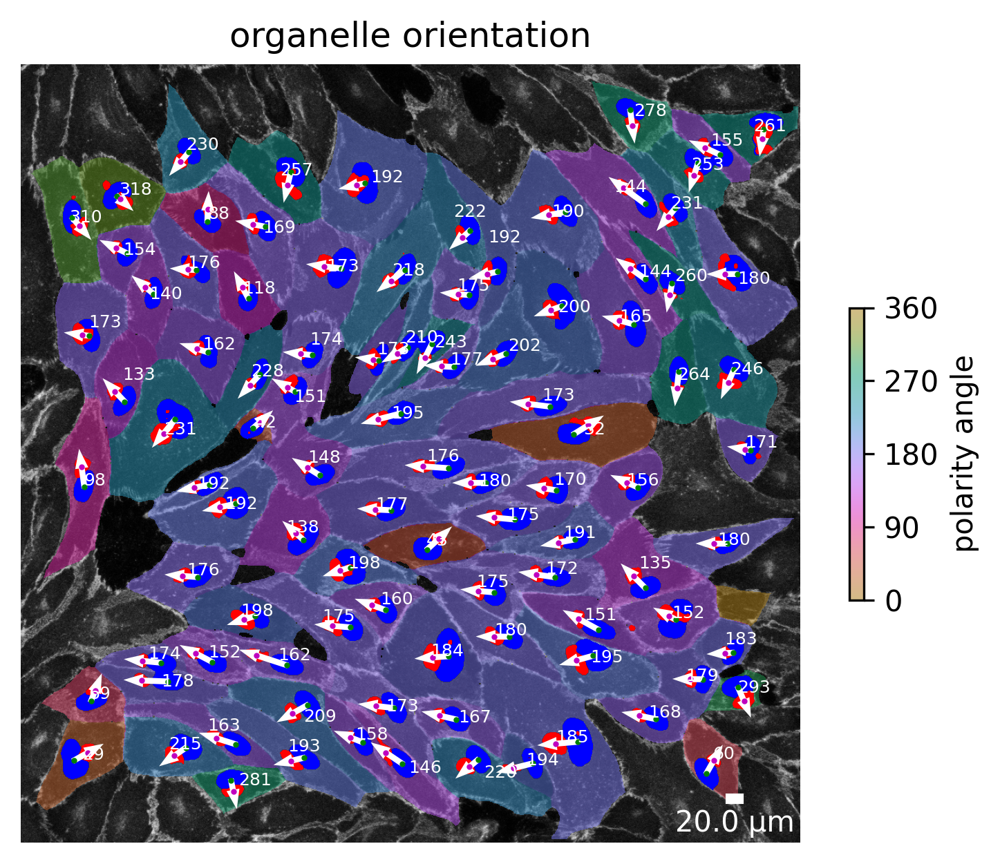

In [15]:
plotter.plot_organelle_polarity(collection, "060721_EGM2_18dyn_01")